In [ ]:
pip install -U googlemaps

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for googlemaps: filename=googlemaps-4.10.0-py3-none-any.whl size=40718 sha256=17b7db55a8f66db9c1288f71b2b8b0400726df41182813e49a638a2e40bae907
  Stored in directory: /root/.cache/pip/wheels/d9/5f/46/54a2bdb4bcb07d3faba4463d2884865705914cc72a7b8bb5f0
Successfully built googlemaps


In [ ]:
pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 14.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 44.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 16.1/16.1 MB 30.4 MB/s eta 0:00:00


In [ ]:
import pandas as pd
from geopy.geocoders import Nominatim
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from folium.plugins import HeatMap
from folium import plugins
from folium.plugins import MarkerCluster
from collections import namedtuple
from shapely.geometry import Point
from geopy.distance import geodesic
import googlemaps
import geopandas # working with geospatial data in python easier
import folium #visualize spatial data in an interactive manner

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns # data visualization library based on matplotlib
import missingno as msn
import matplotlib.pyplot as plt

In [ ]:
# load crime and college datasets into Pandas DataFrames
ss1 = "/content/crime.csv"
crime_df = pd.read_csv(ss1)
ss2 = '/content/Universities_Colleges.csv'
college_df = pd.read_csv(ss2)

pd.set_option('display.max_columns', None)

In [ ]:
crime_df.head()

,Dc_Dist,Psa,Dispatch_Date_Time,Dispatch_Date,Dispatch_Time,Hour,Dc_Key,Location_Block,UCR_General,Text_General_Code,Police_Districts,Month,Lon,Lat
0,18,3,2009-10-02 14:24:00,2009-10-02,14:24:00,14.0,2.009181e+11,S 38TH ST / MARKETUT ST,800.0,Other Assaults,NaN,2009-10,NaN,NaN
1,14,1,2009-05-10 00:55:00,2009-05-10,00:55:00,0.0,2.009140e+11,8500 BLOCK MITCH,2600.0,All Other Offenses,NaN,2009-05,NaN,NaN
2,25,J,2009-08-07 15:40:00,2009-08-07,15:40:00,15.0,2.009251e+11,6TH CAMBRIA,800.0,Other Assaults,NaN,2009-08,NaN,NaN
3,35,D,2009-07-19 01:09:00,2009-07-19,01:09:00,1.0,2.009351e+11,5500 BLOCK N 5TH ST,1500.0,Weapon Violations,20.0,2009-07,-75.130477,40.036389
4,9,R,2009-06-25 00:14:00,2009-06-25,00:14:00,0.0,2.009090e+11,1800 BLOCK WYLIE ST,2600.0,All Other Offenses,8.0,2009-06,-75.166350,39.969532


In [ ]:
college_df.head()

,OBJECTID,NAME,ADDRESS,BUILDING_DESCRIPTION,PARCEL_ID,BRT_ID,TENCODE_ID,GROSS_AREA,Shape__Area,Shape__Length
0,1,Temple University,2450 W HUNTING PARK AVE,OFF/BLD N/COMM W-PKG MASO,155059,883380850,4404002450,231347,231347.864563,2519.967862
1,2,Temple University,1501-39 MARKET ST,OFF/BLDG COMM NO GAR MASO,392760,883337500,5356001501,47425,47426.015198,1281.725069
2,3,Temple University Medical,801 CHERRY ST,APTS 51-100UNTS MASONRY,13161,771524500,2274000801,29301,29348.386963,707.277624
3,4,Temple University Medical,800-20 RACE ST,SCHOOL 7STY MASONRY,324604,771524000,6712000800,34030,33840.214539,746.550259
4,5,Temple University Medical,191-99 E HUNTINGDON ST,HSE WORSHIP ALL3STY MASON,18474,777204000,4406000191,22500,22697.678589,602.634106


**Fix up the data:** 
Convert the college campus addresses to longitude/latitude so we can map them

In [ ]:
# Replace with your Google Maps API key
api_key = ''
gmaps_client = googlemaps.Client(key=api_key)

# Assuming college_df is your DataFrame with 'ADDRESS' column

def get_geocode_result(address):
    address = f"{address}, USA"
    try:
        result = gmaps_client.geocode(address)
        if result and len(result) > 0:
            return result[0]
        else:
            print(f"No result found for address: {address}")
            return None
    except Exception as e:
        print(f"Error geocoding address '{address}': {e}")
        return None

college_df['location'] = college_df['ADDRESS'].apply(get_geocode_result)
college_df['latitude'] = college_df['location'].apply(lambda x: x['geometry']['location']['lat'] if x else None)
college_df['longitude'] = college_df['location'].apply(lambda x: x['geometry']['location']['lng'] if x else None)


In [ ]:
college_df

,OBJECTID,NAME,ADDRESS,BUILDING_DESCRIPTION,PARCEL_ID,BRT_ID,TENCODE_ID,GROSS_AREA,Shape__Area,Shape__Length,location,latitude,longitude
0,1,Temple University,2450 W HUNTING PARK AVE,OFF/BLD N/COMM W-PKG MASO,155059,883380850,4404002450,231347,231347.864563,2519.967862,"{'address_components': [{'long_name': '2450', ...",40.007452,-75.168583
1,2,Temple University,1501-39 MARKET ST,OFF/BLDG COMM NO GAR MASO,392760,883337500,5356001501,47425,47426.015198,1281.725069,"{'address_components': [{'long_name': '1501', ...",39.952696,-75.165672
2,3,Temple University Medical,801 CHERRY ST,APTS 51-100UNTS MASONRY,13161,771524500,2274000801,29301,29348.386963,707.277624,{'address_components': [{'long_name': 'Cherry ...,32.751885,-97.334867
3,4,Temple University Medical,800-20 RACE ST,SCHOOL 7STY MASONRY,324604,771524000,6712000800,34030,33840.214539,746.550259,{'address_components': [{'long_name': 'APT 20'...,39.954769,-75.153279
4,5,Temple University Medical,191-99 E HUNTINGDON ST,HSE WORSHIP ALL3STY MASON,18474,777204000,4406000191,22500,22697.678589,602.634106,{'address_components': [{'long_name': '191-99'...,39.989126,-75.127666
...,...,...,...,...,...,...,...,...,...,...,...,...,...
624,625,Saint Joseph's University,6300-18 CITY AVE,APTS DORMITORY MASONRY,138208,774505000,2324006300,38949,38949.225830,799.417379,"{'address_components': [{'long_name': '18', 's...",39.989278,-75.250924
625,626,Saint Joseph's University,2443-45 N 54TH ST,SCHOOL 1STY MASONRY,64323,774506100,8887002443,24920,24920.548157,758.430079,"{'address_components': [{'long_name': '45', 's...",39.995503,-75.233482
626,627,Saint Joseph's University,6050 OVERBROOK AVE,APTS 5-50 UNTS MASONRY,140338,774579500,6200006050,26202,26202.316528,645.796758,{'address_components': [{'long_name': 'Ashwood...,39.990122,-75.248043
627,628,Academy of Vocal Arts,1916 SPRUCE ST,SCHOOL 4STY MASONRY,181746,772522900,7396001916,3056,3121.867920,300.908322,{'address_components': [{'long_name': 'Spruce ...,39.950728,-75.194794


In [ ]:
from google.colab import files
college_df.to_csv('collegedf.csv', encoding = 'utf-8-sig') 
files.download('collegedf.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# use geopy library to get latitude and longitude of each address
#geolocator = Nominatim(user_agent='crime_prediction',timeout=10)

#college_df['location'] = college_df['ADDRESS'].apply(geolocator.geocode)
#college_df['latitude'] = college_df['location'].apply(lambda x: x.latitude if x else None)
#college_df['longitude'] = college_df['location'].apply(lambda x: x.longitude if x else None)


In [ ]:
college_df = college_df.dropna()

In [ ]:
print(college_df['NAME'].unique())

['Temple University' 'Temple University Medical' 'University of the Arts'
 'La Salle University' 'Community College of Philadelphia'
 'Strayer University' 'JNA School of Culinary Arts'
 'Hussian College School of Art' 'Peirce College' 'Holy Family University'
 'Art Institute of Philadelphia' 'Moore College of Art and Design'
 'Curtis Institute of Music' 'Chestnut Hill College'
 'The Restaurant School at Walnut Hill College' 'Philadelphia University'
 'Philadelphia College of Osteopathic Medicine'
 'Thomas Jefferson University' 'Lutheran Theological Seminary'
 'Pennsylvania Academy of Fine Arts'
 'University of the Sciences in Philadelphia' 'University of Pennsylvania'
 'Drexel University' "Saint Joseph's University" 'Academy of Vocal Arts']


For the crime dataframe: create seperate lists so we can sort by time and remove nan values

In [ ]:
# remove all na values from the dataset
# acpc == All Crime Philidelphia Cleaned
crime_df = crime_df.dropna()

# changing dtype police district to int
crime_df = crime_df.astype({'Police_Districts': 'int64'})

# order based on date
crime_df['Dispatch_Date_Time'] = pd.to_datetime(crime_df['Dispatch_Date_Time'])
crime_df = crime_df.sort_values(by='Dispatch_Date_Time', ascending=True)

# creating a seperate list for each year, month and day 
crime_df['Year_Nr'] = crime_df['Dispatch_Date_Time'].dt.year
crime_df['Month_Nr'] = crime_df['Dispatch_Date_Time'].dt.month
crime_df['Day_Nr'] = crime_df['Dispatch_Date_Time'].dt.day

# removing the year 2017 since it's not a complete year
crime_df = crime_df[crime_df.Year_Nr != 2017]

# showing the first 5 rows
crime_df.head()

,Dc_Dist,Psa,Dispatch_Date_Time,Dispatch_Date,Dispatch_Time,Hour,Dc_Key,Location_Block,UCR_General,Text_General_Code,Police_Districts,Month,Lon,Lat,Year_Nr,Month_Nr,Day_Nr
1381,14,F,2006-01-01 22:19:00,2006-01-01,22:19:00,22.0,2.006140e+11,E CHELTEN AV /CHEW AVE,300.0,Robbery Firearm,10,2006-01,-75.164834,40.045477,2006,1,1
1384,14,O,2006-01-02 19:41:00,2006-01-02,19:41:00,19.0,2.006140e+11,200 BLOCK W ALLENS LN,300.0,Robbery Firearm,10,2006-01,-75.195302,40.058017,2006,1,2
1605,35,M,2006-01-06 12:17:00,2006-01-06,12:17:00,12.0,2.006350e+11,6000 BLOCK N NORWOOD ST,1100.0,Fraud,20,2006-01,-75.156508,40.046049,2006,1,6
1284,6,E,2006-01-07 17:28:00,2006-01-07,17:28:00,17.0,2.006060e+11,100 BLOCK S 11TH ST,800.0,Other Assaults,5,2006-01,-75.158664,39.949826,2006,1,7
1149,1,A,2006-01-09 09:59:00,2006-01-09,09:59:00,9.0,2.006010e+11,1900 BLOCK S MOLE ST,1100.0,Fraud,1,2006-01,-75.171860,39.927010,2006,1,9


In [ ]:
num_records = crime_df.shape[0]
print(num_records)


2184091


**Map Data with Campus Locations**

Total crime

In [ ]:
lon = crime_df['Lon']
lat = crime_df['Lat']
avgLon = sum(lon)/len(lon)
avgLat = sum(lat)/len(lat)
# Create map centered on Philadelphia
m =folium.Map(location=[avgLat, avgLon], 
                       tiles = "Stamen Toner",
                      zoom_start = 11)

# Create MarkerCluster group
marker_cluster = MarkerCluster().add_to(m)

# Add markers for each college location
for i, row in college_df.iterrows():
    folium.Marker(location=[row['latitude'], row['longitude']], popup=row['NAME']).add_to(marker_cluster)

# Add data for heatmap 
data_heatmap = crime_df[-25000:]
data_heatmap = data_heatmap[['Lat','Lon']]
data_heatmap = [[row['Lat'],row['Lon']] for index, row in data_heatmap.iterrows()]
HeatMap(data_heatmap, radius=10).add_to(m)

# Display the map
m


Violent Crime Map

In [ ]:
crime_df.Text_General_Code.unique()

# The most dangerous crime (weapon involved) types that can be commited
dangerous = ['Weapon Violations', 'Robbery Firearm', 'Homicide - Criminal', 'Aggravated Assault Firearm', 'Homicide - Gross Negligence', 'Homicide - Justifiable']
# creating a new dataframe with all the dangerous crimes in it
dangerous_data = crime_df[crime_df['Text_General_Code'].isin(dangerous)]

dangerous_data.head()

,Dc_Dist,Psa,Dispatch_Date_Time,Dispatch_Date,Dispatch_Time,Hour,Dc_Key,Location_Block,UCR_General,Text_General_Code,Police_Districts,Month,Lon,Lat,Year_Nr,Month_Nr,Day_Nr
1325562,18,Q,2006-01-01 00:04:00,2006-01-01,00:04:00,0,200618000007,400 BLOCK S 55TH ST,1500.0,Weapon Violations,14,2006-01,-75.232374,39.953490,2006,1,1
1395649,12,P,2006-01-01 00:05:00,2006-01-01,00:05:00,0,200612000011,1700 BLOCK S 58TH ST,1500.0,Weapon Violations,9,2006-01,-75.230711,39.937644,2006,1,1
1396015,35,R,2006-01-01 00:09:00,2006-01-01,00:09:00,0,200635000008,6600 BLOCK N 18TH ST,1500.0,Weapon Violations,20,2006-01,-75.147835,40.055032,2006,1,1
1351717,39,G,2006-01-01 00:10:00,2006-01-01,00:10:00,0,200639000009,1900 BLOCK W SOMERSET ST,1500.0,Weapon Violations,21,2006-01,-75.162725,39.996597,2006,1,1
1337776,24,C,2006-01-01 00:21:00,2006-01-01,00:21:00,0,200624000010,2800 BLOCK RUTH ST,1500.0,Weapon Violations,17,2006-01,-75.122057,39.990907,2006,1,1


In [ ]:
lon = dangerous_data['Lon']
lat = dangerous_data['Lat']
avgLon = sum(lon)/len(lon)
avgLat = sum(lat)/len(lat)

crime_map = folium.Map(location=[avgLat, avgLon], 
                       tiles = "Stamen Toner",
                       zoom_start = 11)

# Add data for heatmap 
data_heatmap = dangerous_data[dangerous_data.Year_Nr == 2016]
data_heatmap = data_heatmap[['Lat','Lon']]
data_heatmap = [[row['Lat'],row['Lon']] for index, row in data_heatmap.iterrows()]

HeatMap(data_heatmap, radius=10).add_to(crime_map)

# Add markers for each campus location
marker_cluster = MarkerCluster().add_to(crime_map)
for i, row in college_df.iterrows():
    folium.Marker(location=[row['latitude'], row['longitude']], popup=row['NAME']).add_to(marker_cluster)

# Plot!
crime_map


Theft Map

In [ ]:
Theft = ['Thefts', 'Theft from Vehicle', 'Motor Vehicle Theft', 'Receiving Stolen Property', 'Recovered Stolen Motor Vehicle']
theft_data = crime_df[crime_df['Text_General_Code'].isin(Theft)]

In [ ]:
lon = theft_data['Lon']
lat = theft_data['Lat']
avgLon = sum(lon)/len(lon)
avgLat = sum(lat)/len(lat)

crime_map = folium.Map(location=[avgLat, avgLon], 
                       tiles = "Stamen Toner",
                       zoom_start = 11)

# Add data for heatmap 
data_heatmap = theft_data[theft_data.Year_Nr == 2016]
data_heatmap = data_heatmap[['Lat','Lon']]
data_heatmap = [[row['Lat'],row['Lon']] for index, row in data_heatmap.iterrows()]
HeatMap(data_heatmap, radius=10).add_to(crime_map)

# Add markers for each campus location
marker_cluster = MarkerCluster().add_to(crime_map)
for i, row in college_df.iterrows():
    folium.Marker(location=[row['latitude'], row['longitude']], popup=row['NAME']).add_to(marker_cluster)
    
# Plot!
crime_map

Text(0.5, 1.0, 'Total number of crimes commited per year')

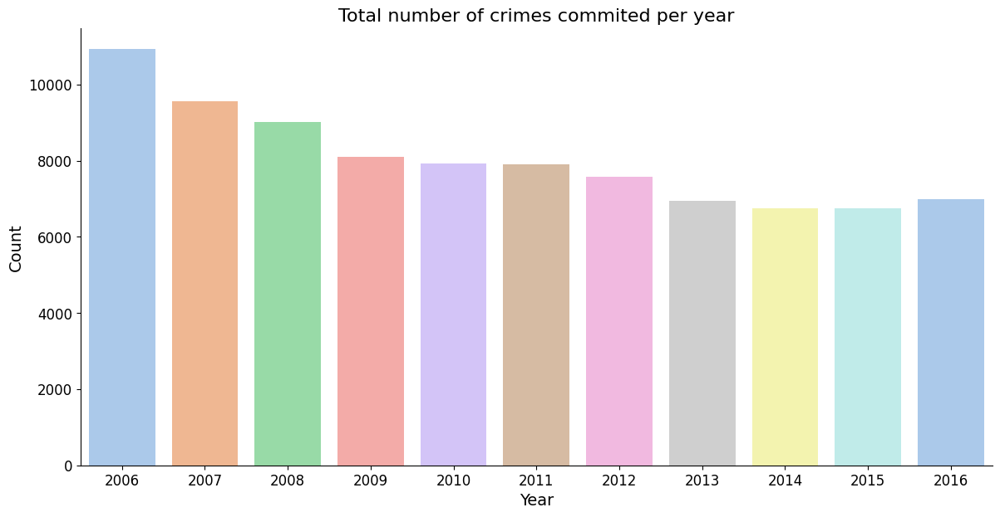

In [ ]:
sns.catplot(x='Year_Nr',
            kind='count',
            palette=("pastel"),
            height=6,
            aspect=2,
            data=dangerous_data)

plt.xticks(size=12)
plt.yticks(size=12)
plt.xlabel("Year", fontsize=14)
plt.ylabel("Count", fontsize=14)
plt.title("Total number of crimes commited per year", fontsize=16)

There is too much data so we narrow down by year or type. Here I chose to use 2015 and 2016 dangerous data


In [ ]:
dangerous_data = dangerous_data.loc[dangerous_data['Year_Nr'].isin([2015,2016])]

In [ ]:
num_records = dangerous_data.shape[0]
print(num_records)

13733


Iterating through crimes and finding if they are close to campus. If they are we note that under 'Close to Campus' and under 'Closest College' what campus they are close to

In [ ]:
from geopy.distance import distance as geodesic
import numpy as np

# Define threshold distance in miles
threshold = 0.1

# Define function to calculate distance between two points
def calculate_distance(lat1, lon1, lat2, lon2):
    return geodesic((lat1, lon1), (lat2, lon2)).miles

# Get college locations and names
college_locations = college_df[['latitude', 'longitude']].to_numpy()
college_names = college_df['NAME'].to_numpy()

# Get crime locations
crime_locations = dangerous_data[['Lat', 'Lon']].to_numpy()

# Calculate distances between colleges and crimes
distances = np.zeros((college_locations.shape[0], crime_locations.shape[0]))
for i in range(college_locations.shape[0]):
    distances[i,:] = np.apply_along_axis(lambda x: calculate_distance(college_locations[i,0], college_locations[i,1], x[0], x[1]), 1, crime_locations)

# Find closest college for each crime
crime_closest_college = np.argmin(distances, axis=0)
crime_closest_distance = np.min(distances, axis=0)

# Add new feature to crime data indicating if it's close to a campus or not
dangerous_data['Close to Campus'] = np.where(crime_closest_distance < threshold, 'Yes', 'No')

# Add new feature to crime data containing the name of the closest college
dangerous_data['Closest College'] = np.where(crime_closest_distance < threshold, college_names[crime_closest_college], np.nan)


In [ ]:
counts = dangerous_data['Close to Campus'].value_counts()
print(counts)

No     13163
Yes      570
Name: Close to Campus, dtype: int64


Saving the data just in case

In [ ]:
dangerous_data

,Unnamed: 0,Dc_Dist,Psa,Dispatch_Date_Time,Dispatch_Date,Dispatch_Time,Hour,Dc_Key,Location_Block,UCR_General,Text_General_Code,Police_Districts,Month,Lon,Lat,Year_Nr,Month_Nr,Day_Nr,Close to Campus,Closest College
0,76422,22,2,2015-01-01 00:02:00,2015-01-01,00:02:00,0,201522000002,N 29TH ST / W SEDGLEY AVE,1500.0,Weapon Violations,16,2015-01,-75.181020,39.985832,2015,1,1,No,NaN
1,211558,24,2,2015-01-01 00:09:00,2015-01-01,00:09:00,0,201524000005,400 BLOCK E CLEARFIELD ST,1500.0,Weapon Violations,17,2015-01,-75.121792,39.995908,2015,1,1,No,NaN
2,366682,35,2,2015-01-01 00:52:00,2015-01-01,00:52:00,0,201535000028,300 BLOCK E SHELDON ST,1500.0,Weapon Violations,20,2015-01,-75.118768,40.027861,2015,1,1,No,NaN
3,385363,39,2,2015-01-01 01:04:00,2015-01-01,01:04:00,1,201539000013,1400 BLOCK W BUTLER ST,1500.0,Weapon Violations,21,2015-01,-75.151166,40.010838,2015,1,1,No,NaN
4,1493958,15,3,2015-01-01 01:22:00,2015-01-01,01:22:00,1,201515000036,6500 BLOCK ROOSEVELT BLVD BLVD,1500.0,Weapon Violations,2,2015-01,-75.064497,40.036733,2015,1,1,No,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13728,2139154,19,3,2016-12-31 18:46:00,2016-12-31,18:46:00,18,201619117590,5200 BLOCK HESTON ST,300.0,Robbery Firearm,15,2016-12,-75.225287,39.980013,2016,12,31,No,NaN
13729,2144336,25,1,2016-12-31 20:09:00,2016-12-31,20:09:00,20,201625110228,3800 BLOCK N CAMAC ST,1500.0,Weapon Violations,18,2016-12,-75.148187,40.010545,2016,12,31,No,NaN
13730,2146755,39,3,2016-12-31 21:10:00,2016-12-31,21:10:00,21,201639106127,2400 BLOCK W SOMERSET ST,1500.0,Weapon Violations,21,2016-12,-75.170449,39.997589,2016,12,31,No,NaN
13731,2146686,17,1,2016-12-31 21:12:00,2016-12-31,21:12:00,21,201617055152,1700 BLOCK WASHINGTON AVE,300.0,Robbery Firearm,13,2016-12,-75.171634,39.938418,2016,12,31,No,NaN


Plot with red dots being crimes committed on campuses

In [ ]:
# Get average longitude and latitude
lon = dangerous_data['Lon']
lat = dangerous_data['Lat']
avgLon = sum(lon)/len(lon)
avgLat = sum(lat)/len(lat)

# Create a map centered at the average location
crime_map = folium.Map(location=[avgLat, avgLon], 
                       tiles="Stamen Toner",
                       zoom_start=11)

# Add data for heatmap 
data_heatmap = dangerous_data[dangerous_data.Year_Nr == 2016]
data_heatmap = data_heatmap[['Lat', 'Lon']]
data_heatmap = [[row['Lat'], row['Lon']] for index, row in data_heatmap.iterrows()]

HeatMap(data_heatmap, radius=10).add_to(crime_map)

# Group close 'close_to_campus' yes's together
close_to_campus = dangerous_data[dangerous_data['Close to Campus'] == 'Yes']
grouped_close_to_campus = close_to_campus.groupby(['Lat', 'Lon']).size().reset_index(name='count')

# Add circle markers for the grouped close 'close_to_campus' yes's
for i, row in grouped_close_to_campus.iterrows():
    folium.CircleMarker(location=[row['Lat'], row['Lon']],
                        radius=row['count']*2,
                        color='red',
                        fill_color='red',
                        fill_opacity=0.5,
                        popup=f"Number of incidents: {row['count']}").add_to(crime_map)

# Add markers for each campus location
marker_cluster = MarkerCluster().add_to(crime_map)
for i, row in college_df.iterrows():
    # Check if campus is close to a dangerous location
    close_to_campus = dangerous_data[(dangerous_data.Lat == row['latitude']) & 
                                     (dangerous_data.Lon == row['longitude']) & 
                                     (dangerous_data['Close to Campus'] == 'Yes')].shape[0] > 0
    # Add marker for campus
    folium.Marker(location=[row['latitude'], row['longitude']], popup=row['NAME']).add_to(marker_cluster)

# Plot the map
crime_map


Remove the outlier colleges that we dont have crime data on

In [ ]:
# Define a bounding box around the Philadelphia region
philly_bbox = {
    "north": 40.14,
    "south": 39.87,
    "west": -75.28,
    "east": -74.95,
}

# Filter the college_df dataframe to only include records whose latitude and longitude values are within the bounding box
college_df = college_df[(college_df["latitude"] >= philly_bbox["south"]) &
                        (college_df["latitude"] <= philly_bbox["north"]) &
                        (college_df["longitude"] >= philly_bbox["west"]) &
                        (college_df["longitude"] <= philly_bbox["east"])]



In [ ]:
college_df = college_df.loc[~((college_df['latitude'] == 39.9651931) & (college_df['longitude'] == -75.0878156))]
college_df = college_df.loc[~((college_df['latitude'] == 39.9463499) & (college_df['longitude'] == -75.0723433))]                            

In [ ]:
# Define the radius of the area to consider around each college (in meters)
radius = 1000

# Create a dictionary to store the number of incidents reported in the vicinity of each college
incidents_by_college = {}

# Loop through each college in the college_df DataFrame
for i, college in college_df.iterrows():

    # Check if there are any incidents reported close to this college
    close_to_campus_filter = (dangerous_data['Close to Campus'] == 'Yes')
    campus_lat_filter = abs(dangerous_data['Lat'] - college['latitude']) < (radius / 111000)
    campus_lon_filter = abs(dangerous_data['Lon'] - college['longitude']) < (radius / 111000)
    incidents_count = dangerous_data[close_to_campus_filter & campus_lat_filter & campus_lon_filter].shape[0]

    # Add the number of incidents to the incidents_by_college dictionary
    incidents_by_college[college['NAME']] = incidents_count
    
# Rank the colleges by the number of incidents reported in their vicinity
ranked_colleges = sorted(incidents_by_college.items(), key=lambda x: x[1], reverse=True)

# Print the ranked list of colleges by risk of crime
for i, college in enumerate(ranked_colleges):
    print(f"{i+1}. {college[0]}: {college[1]} incidents")


1. Temple University Medical: 77 incidents
2. Drexel University: 53 incidents
3. La Salle University: 52 incidents
4. Temple University: 46 incidents
5. University of Pennsylvania: 42 incidents
6. The Restaurant School at Walnut Hill College: 35 incidents
7. University of the Sciences in Philadelphia: 35 incidents
8. Philadelphia College of Osteopathic Medicine: 22 incidents
9. Thomas Jefferson University: 15 incidents
10. University of the Arts: 13 incidents
11. Strayer University: 9 incidents
12. Curtis Institute of Music: 8 incidents
13. Pennsylvania Academy of Fine Arts: 8 incidents
14. Academy of Vocal Arts: 6 incidents
15. Moore College of Art and Design: 4 incidents
16. Community College of Philadelphia: 3 incidents
17. Holy Family University: 3 incidents
18. Lutheran Theological Seminary: 1 incidents
19. Saint Joseph's University: 1 incidents
20. JNA School of Culinary Arts: 0 incidents
21. Chestnut Hill College: 0 incidents
22. Philadelphia University: 0 incidents


Model

In [ ]:
dangerous_data.head()

,Unnamed: 0,Dc_Dist,Psa,Dispatch_Date_Time,Dispatch_Date,Dispatch_Time,Hour,Dc_Key,Location_Block,UCR_General,Text_General_Code,Police_Districts,Month,Lon,Lat,Year_Nr,Month_Nr,Day_Nr,Close to Campus,Closest College
0,76422,22,2,2015-01-01 00:02:00,2015-01-01,00:02:00,0,201522000002,N 29TH ST / W SEDGLEY AVE,1500.0,Weapon Violations,16,2015-01,-75.181020,39.985832,2015,1,1,No,NaN
1,211558,24,2,2015-01-01 00:09:00,2015-01-01,00:09:00,0,201524000005,400 BLOCK E CLEARFIELD ST,1500.0,Weapon Violations,17,2015-01,-75.121792,39.995908,2015,1,1,No,NaN
2,366682,35,2,2015-01-01 00:52:00,2015-01-01,00:52:00,0,201535000028,300 BLOCK E SHELDON ST,1500.0,Weapon Violations,20,2015-01,-75.118768,40.027861,2015,1,1,No,NaN
3,385363,39,2,2015-01-01 01:04:00,2015-01-01,01:04:00,1,201539000013,1400 BLOCK W BUTLER ST,1500.0,Weapon Violations,21,2015-01,-75.151166,40.010838,2015,1,1,No,NaN
4,1493958,15,3,2015-01-01 01:22:00,2015-01-01,01:22:00,1,201515000036,6500 BLOCK ROOSEVELT BLVD BLVD,1500.0,Weapon Violations,2,2015-01,-75.064497,40.036733,2015,1,1,No,NaN


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, r2_score

# preprocess the data
#dangerous_data['is_college'] = dangerous_data['Close to Campus'].apply(lambda x: 1 if x != 'No' else 0)
#dangerous_data = dangerous_data.drop(['Close to Campus','Dispatch_Date_Time','Dc_Dist','Psa','Dispatch_Date','Dispatch_Time','Hour','Dc_Key','Location_Block','UCR_General','Police_Districts','Month','Text_General_Code','Closest College'], axis=1)
#dangerous_data = dangerous_data.drop(['Text_General_Code'], axis=1)
#dangerous_data = dangerous_data.drop(['Closest College'], axis=1)
# split the data into training and testing sets
X = dangerous_data.drop(['Lat', 'Lon'], axis=1)
y_lat = dangerous_data['Lat']
y_lon = dangerous_data['Lon']
X_train, X_test, y_lat_train, y_lat_test, y_lon_train, y_lon_test = train_test_split(X, y_lat, y_lon, test_size=0.2, random_state=42)

# train multiple regressors and evaluate their accuracy
regressors = {
    'Random Forest': RandomForestRegressor(n_estimators=100, random_state=42),
    'Gradient Boosting': GradientBoostingRegressor(n_estimators=100, random_state=42),
    'SVM': SVR(kernel='linear')
}

best_rmse = float('inf')
best_regressor = None

for name, reg in regressors.items():
    reg.fit(X_train, y_lat_train)
    y_lat_pred = reg.predict(X_test)
    rmse_lat = mean_squared_error(y_lat_test, y_lat_pred, squared=False)
    r2_lat = r2_score(y_lat_test, y_lat_pred)
    
    reg.fit(X_train, y_lon_train)
    y_lon_pred = reg.predict(X_test)
    rmse_lon = mean_squared_error(y_lon_test, y_lon_pred, squared=False)
    r2_lon = r2_score(y_lon_test, y_lon_pred)

    print(f'{name} RMSE for latitude: {rmse_lat:.2f}, R2 score: {r2_lat:.2f}')
    print(f'{name} RMSE for longitude: {rmse_lon:.2f}, R2 score: {r2_lon:.2f}')

    avg_rmse = (rmse_lat + rmse_lon) / 2
    if avg_rmse < best_rmse:
        best_rmse = avg_rmse
        best_regressor = reg

print(f'The best regressor is {type(best_regressor).__name__} with an average RMSE of {best_rmse:.2f}.')


Random Forest RMSE for latitude: 0.04, R2 score: -0.06
Random Forest RMSE for longitude: 0.06, R2 score: -0.06
Gradient Boosting RMSE for latitude: 0.04, R2 score: 0.00
Gradient Boosting RMSE for longitude: 0.05, R2 score: 0.00
SVM RMSE for latitude: 0.04, R2 score: -0.08
SVM RMSE for longitude: 0.06, R2 score: -0.08
The best regressor is GradientBoostingRegressor with an average RMSE of 0.05.


In [ ]:
# use the best regressor to predict on test data
y_lat_pred = GradientBoostingRegressor.predict(X_test)
rmse_lat = mean_squared_error(y_lat_test, y_lat_pred, squared=False)
r2_lat = r2_score(y_lat_test, y_lat_pred)

y_lon_pred = SVR.predict(X_test)
rmse_lon = mean_squared_error(y_lon_test, y_lon_pred, squared=False)
r2_lon = r2_score(y_lon_test, y_lon_pred)

print(f'{type(best_regressor).__name__} RMSE for latitude: {rmse_lat:.2f}, R2 score: {r2_lat:.2f}')
print(f'{type(best_regressor).__name__} RMSE for longitude: {rmse_lon:.2f}, R2 score: {r2_lon:.2f}')


TypeError: ignored

In [ ]:
# use the regressors to predict on test data and save the predictions
for name, reg in regressors.items():
    reg.fit(X_train, y_lat_train)
    y_lat_pred = reg.predict(X_test)
    np.savetxt(f'{name}_y_lat_pred.csv', y_lat_pred, delimiter=',')
    
    reg.fit(X_train, y_lon_train)
    y_lon_pred = reg.predict(X_test)
    np.savetxt(f'{name}_y_lon_pred.csv', y_lon_pred, delimiter=',')


In [ ]:
# use the best regressor to predict on test data
y_lat_pred = best_regressor.predict(X_test)
rmse_lat = mean_squared_error(y_lat_test, y_lat_pred, squared=False)
r2_lat = r2_score(y_lat_test, y_lat_pred)

y_lon_pred = best_regressor.predict(X_test)
rmse_lon = mean_squared_error(y_lon_test, y_lon_pred, squared=False)
r2_lon = r2_score(y_lon_test, y_lon_pred)

print(f'{type(best_regressor).__name__} RMSE for latitude: {rmse_lat:.2f}, R2 score: {r2_lat:.2f}')
print(f'{type(best_regressor).__name__} RMSE for longitude: {rmse_lon:.2f}, R2 score: {r2_lon:.2f}')

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import mean_squared_error
import joblib

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(
    dangerous_data.drop(['Lat', 'Lon'], axis=1), dangerous_data[['Lat', 'Lon']], test_size=0.3, random_state=42)

# Define the regressors
regressors = {
    'Linear Regression': LinearRegression(),
    'Decision Tree Regressor': DecisionTreeRegressor(),
    'Random Forest Regressor': RandomForestRegressor(),
    'MLP Regressor': MLPRegressor(hidden_layer_sizes=(100, 50), max_iter=500)
}

# Train and evaluate the models
scores = {}
for name, reg in regressors.items():
    reg.fit(X_train, y_train)
    y_pred = reg.predict(X_test)
    rmse = mean_squared_error(y_test, y_pred, squared=False)
    print(f'{name} RMSE: {rmse}')
    scores[name] = rmse

# Find the best model based on validation score
best_model_name = min(scores, key=scores.get)
best_model = regressors[best_model_name]
print(f'Best Model: {best_model_name}')

# Save the best model
joblib.dump(best_model, 'best_model.pkl')

# Load the best model and make predictions on test data
loaded_model = joblib.load('best_model.pkl')
y_pred_test = loaded_model.predict(X_test)

Linear Regression RMSE: 0.047391395194365554
Decision Tree Regressor RMSE: 0.04900988650160756
Random Forest Regressor RMSE: 0.04888805683471183
MLP Regressor RMSE: 0.06915990444139548
Best Model: Linear Regression


In [ ]:
# Create a map to visualize the predictions and actual values
import folium

# Get average latitude and longitude
avgLat = dangerous_data['Lat'].mean()
avgLon = dangerous_data['Lon'].mean()

# Create a map centered at the average location
crime_map = folium.Map(location=[avgLat, avgLon], 
                       tiles="Stamen Toner",
                       zoom_start=11)

# Add markers for the actual values
for i, row in dangerous_data.iterrows():
    folium.CircleMarker(location=[row['Lat'], row['Lon']],
                        radius=3,
                        color='blue',
                        fill_color='blue',
                        fill_opacity=0.5).add_to(crime_map)

# Add markers for the predicted values
# Load the predicted values from CSV files
y_lat_pred = pd.read_csv('Gradient Boosting_y_lat_pred.csv', names=['Lat']).values
y_lon_pred = pd.read_csv('Gradient Boosting_y_lon_pred.csv', names=['Lon']).values
# Add markers for the predicted values
for i, (lat, lon) in enumerate(zip(y_lat_pred, y_lon_pred)):
    folium.CircleMarker(location=[lat, lon],
                        radius=3,
                        color='red',
                        fill_color='red',
                        fill_opacity=0.5).add_to(crime_map)


# Plot the map
crime_map

In [ ]:
# Create a map to visualize the predictions and actual values
import folium

# Get average latitude and longitude
avgLat = dangerous_data['Lat'].mean()
avgLon = dangerous_data['Lon'].mean()

# Create a map centered at the average location
crime_map = folium.Map(location=[avgLat, avgLon], 
                       tiles="Stamen Toner",
                       zoom_start=11)

# Add markers for the actual values
for i, row in dangerous_data.iterrows():
    folium.CircleMarker(location=[row['Lat'], row['Lon']],
                        radius=3,
                        color='blue',
                        fill_color='blue',
                        fill_opacity=0.5).add_to(crime_map)

# Add markers for the predicted values
# Load the predicted values from CSV files
y_lat_pred = pd.read_csv('Random Forest_y_lat_pred.csv', names=['Lat']).values
y_lon_pred = pd.read_csv('Random Forest_y_lon_pred.csv', names=['Lon']).values
# Add markers for the predicted values
for i, (lat, lon) in enumerate(zip(y_lat_pred, y_lon_pred)):
    folium.CircleMarker(location=[lat, lon],
                        radius=3,
                        color='red',
                        fill_color='red',
                        fill_opacity=0.5).add_to(crime_map)


# Plot the map
crime_map

In [ ]:
# Create a map to visualize the predictions and actual values
import folium

# Get average latitude and longitude
avgLat = dangerous_data['Lat'].mean()
avgLon = dangerous_data['Lon'].mean()

# Create a map centered at the average location
crime_map = folium.Map(location=[avgLat, avgLon], 
                       tiles="Stamen Toner",
                       zoom_start=11)

# Add markers for the actual values
for i, row in dangerous_data.iterrows():
    folium.CircleMarker(location=[row['Lat'], row['Lon']],
                        radius=3,
                        color='blue',
                        fill_color='blue',
                        fill_opacity=0.5).add_to(crime_map)

# Add markers for the predicted values
# Load the predicted values from CSV files
y_lat_pred = pd.read_csv('SVM_y_lat_pred.csv', names=['Lat']).values
y_lon_pred = pd.read_csv('SVM_y_lon_pred.csv', names=['Lon']).values
# Add markers for the predicted values
for i, (lat, lon) in enumerate(zip(y_lat_pred, y_lon_pred)):
    folium.CircleMarker(location=[lat, lon],
                        radius=3,
                        color='red',
                        fill_color='red',
                        fill_opacity=0.5).add_to(crime_map)


# Plot the map
crime_map

In [ ]:
import pandas as pd
import numpy as np
from sklearn.cluster import DBSCAN

def create_crime_clusters(dangerous_data, college_df, radius=1000, min_samples=5, eps=100):
    close_to_campus_crimes = []

    for i, college in college_df.iterrows():
        campus_lat_filter = abs(dangerous_data['Lat'] - college['latitude']) < (radius / 111000)
        campus_lon_filter = abs(dangerous_data['Lon'] - college['longitude']) < (radius / 111000)
        close_to_campus_crimes.append(dangerous_data[campus_lat_filter & campus_lon_filter])

    close_to_campus_crimes = pd.concat(close_to_campus_crimes).drop_duplicates().reset_index(drop=True)

    # Prepare data for DBSCAN
    coords = close_to_campus_crimes[['Lat', 'Lon']].values

    # Apply DBSCAN clustering
    db = DBSCAN(eps=eps/111000, min_samples=min_samples, metric='euclidean').fit(coords)
    cluster_labels = db.labels_

    # Add cluster labels to the crime data
    close_to_campus_crimes['Cluster'] = cluster_labels

    return close_to_campus_crimes


Save Files for Modeling

In [ ]:
from google.colab import files
dangerous_data.to_csv('1516danger3.csv', encoding = 'utf-8-sig') 
files.download('1516danger3.csv')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
from google.colab import files
college_df.to_csv('collegedf.csv', encoding = 'utf-8-sig') 
files.download('collegedf.csv')